In [256]:
import numpy as np 
import pandas as pd 
import altair as alt
from venn import venn 
import upsetplot
import matplotlib.pyplot as plt
from commons import data_processing
from commons import generate_hex
from scipy import stats
import seaborn as sns

In [238]:
data = r'./Working_Datafiles/All_N_Glycopeptides.csv'
df = pd.read_csv(data)

In [239]:
df.loc[:, 'run'] = df.run.apply(lambda x: x.lower())
df.loc[:, 'dilution_val'] = df.dilution.map(lambda x: int(x.replace('x', '')))

In [240]:
df.dilution_val.unique()

array([ 8,  4,  2,  1, 16], dtype=int64)

In [241]:
colors = generate_hex.generate_colors(['#6E6581', '#B0B2BB', '#6B8A97'], 5)

base = alt.Chart(df).encode(
    x=alt.X('temperature:O', title='',
        axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('distinct(pep_mods):Q', title=''),
    color=alt.Color('dilution:N',
        scale=alt.Scale(range=colors))
).properties(width=200)


base = alt.Chart(df).encode(
    x=alt.X('temperature:O', title='',
        axis=alt.Axis(
            labelAngle=0, 
            labelAlign='center', 
            labelFontSize=12, 
            labelFontWeight='bold')),
    y=alt.Y('mean(my_count):Q', title='# Unique Glycopeptides',
        axis=alt.Axis(
            labelAngle=0, 
            labelFontSize=12, 
            labelFontWeight='bold',
            tickMinStep=100)),
    color=alt.Color('dilution_val:N',
        scale=alt.Scale(range=colors))
).transform_aggregate(
    my_count = 'distinct(pep_mods):Q',
    groupby=['dilution_val', 'temperature', 'run']
).properties(width=200)

dots = base.mark_circle(size=65)
lines = base.mark_line()


err = alt.Chart(df).mark_errorbar(extent='stdev', color='#000000').encode(
    x=alt.X('temperature:O', title=''),
    y=alt.Y('mean(my_count):Q', title=''),
    color=alt.Color('dilution_val:N', legend=None,
        scale=alt.Scale(range=['#000000']))
).transform_aggregate(
    my_count = 'distinct(pep_mods):Q',
    groupby=['dilution_val', 'temperature', 'run']
).properties(width=200)

# err = base.mark_errorbar(extent='stdev', color='#000000')

(dots + lines + err).resolve_scale(color='independent').properties(title='Unique Glycopeptides')

alt.LayerChart(...)

In [242]:
glycan_color_scale = alt.Scale(
    domain=[
        'Sialylated',
        'Fucosylated',
        'Complex',
        'Paucimannose',
        'High Mannose',
    ],
    range=[
        '#6E6581',
        '#AF3A53',
        '#6B8A97',
        '#B0B2BB',
        '#658A64',
    ]
)

base = alt.Chart(df).encode(
    x=alt.X('temperature:O', title='',
        axis=alt.Axis(labelAngle=0, labelAlign='center')),
    y=alt.Y('mean(glycan_count):Q', title=''),
    color=alt.Color('glycan_type:N', scale=glycan_color_scale)
).transform_aggregate(
    glycan_count='distinct(pep_mods):Q',
    groupby=['temperature', 'run']
).properties(width=100)

bars = base.mark_bar()
err = alt.Chart(df).mark_errorbar(color='#000000').encode(
    x=alt.X('temperature:O', title='',
        axis=alt.Axis(labelAngle=0, labelAlign='center')),
    y=alt.Y('mean(glycan_count):Q', title=''),
).transform_aggregate(
    glycan_count='distinct(pep_mods):Q',
    groupby=['temperature', 'run']
).properties(width=100)

(bars + err).resolve_scale(color='independent').facet(column='glycan_type:N')

alt.FacetChart(...)

In [243]:
t = df.groupby(['pep_mods', 'temperature', 'dilution']).count()
t = t.reset_index(drop=False)
counts = t['pep_mods'].value_counts()
valid = counts[counts.values == 15].keys()
df[df.pep_mods.isin(valid)].accession.unique()

array(['P61823', 'P12763', 'Q3SZR3', 'Q9Y4L1', 'P50454', 'P13473',
       'P11279'], dtype=object)

In [244]:
# for each temperature, found out how many gps are identifiable in 3, 4, 5 dilutions

found_in = []
glycan_type = []
temps = []
peptides = []

for temperature, t_frame in data_processing.iterate_contents('temperature', df, get_item=True):
    t_counts = t_frame.groupby(['pep_mods', 'dilution'], as_index=False).count()
    counts = t_counts.pep_mods.value_counts()
    for i in range(3, 6):
        valid = counts[counts.values == i].keys()
        num_quant = valid.shape[0]
        found_in.extend([i] * num_quant)
        temps.extend([temperature] * num_quant)
        valid_frame = t_frame[t_frame.pep_mods.isin(valid)][['pep_mods', 'glycan_type']].drop_duplicates()
        glycan_type.extend(valid_frame.glycan_type.tolist())
        peptides.extend(valid_frame.pep_mods.tolist())


quant_count = pd.DataFrame({
    'identified_in':found_in,
    'temperature':temps,
    'glycopeptide':peptides,
    'glycan_type':glycan_type
})

alt.Chart(quant_count).mark_bar().encode(
    x=alt.X('temperature:O', title=''),
    y=alt.Y('count(identified_in):Q', stack='zero'), 
    color=alt.Color('identified_in:N')
).facet(column='glycan_type:O')

alt.FacetChart(...)

In [253]:
all_quant = pd.DataFrame()

b_quant = pd.DataFrame()

for temperature, t_frame in data_processing.iterate_contents('temperature', df, get_item=True):
    search = quant_count[quant_count.temperature==temperature]
    q = t_frame[t_frame.pep_mods.isin(search.glycopeptide)]
    q = q.groupby(['pep_mods', 'dilution', 'temperature', 'glycan_type'], as_index=False).mean()
    small = q[['pep_mods', 'temperature', 'dilution', 'dilution_val', 'num_psms', 'glycan_type']]

    for p_frame in data_processing.iterate_contents('pep_mods', small):
        x = stats.linregress(p_frame.dilution_val, p_frame.num_psms)
        # print(f'y = {m:.2f}x + {b:.2f}')
        if x.rvalue < -0.8:
            p_frame.loc[:, 'r'] = x.rvalue 
            p_frame.loc[:, 'line'] = (x.slope * p_frame.dilution_val) + x.intercept 
            all_quant = pd.concat([all_quant, p_frame])
            all_quant.reset_index(drop=True)

        elif x.rvalue > 0.8:
            b_quant = pd.concat([b_quant, p_frame])
            b_quant.reset_index(drop=True)

all_quant.loc[:, 'r'] = abs(all_quant.r)

c:\Users\Graham Delafield\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\core\indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


In [254]:
base = alt.Chart(all_quant).encode(
    x=alt.X('dilution_val:Q', title=''),
)

dots = base.mark_circle().encode(
    y=alt.Y('num_psms:Q', title='Numer of PSMs'),
    color=alt.Color('glycan_type:N', legend=None, scale=glycan_color_scale),
    detail='pep_mods:O'
).properties(width=200, height=100)

lines = base.mark_line(opacity=0.5).encode(
    y=alt.Y('line:Q', title=''),
    color=alt.Color('glycan_type:N', legend=None, scale=glycan_color_scale),
    detail='pep_mods:O'
)
(dots + lines).facet(column='glycan_type', row='temperature').resolve_scale(color='independent', y='independent')

alt.FacetChart(...)

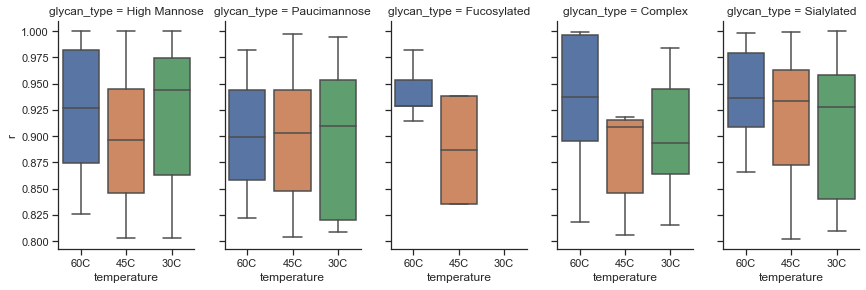

In [255]:
sns.set_theme(style="ticks")
sns.catplot(x='temperature', y='r', col='glycan_type', data=all_quant, kind='box', height=4, aspect=0.6)

In [288]:
temp_quant = pd.DataFrame()

for dilution, d_frame in data_processing.iterate_contents('dilution', df, get_item=True):
    d_frame = d_frame.groupby(['pep_mods', 'temperature', 'dilution', 'glycan_type'], as_index=False).mean()
    counts = d_frame.pep_mods.value_counts()
    valid = counts[counts.values == 3].keys()
    valid = d_frame[d_frame.pep_mods.isin(valid)]

    taken = valid[['pep_mods', 'temperature', 'dilution', 'num_psms', 'glycan_type']]
    temp_quant = pd.concat([temp_quant, taken])
    temp_quant = temp_quant.reset_index(drop=True)

for pep, p_frame in data_processing.iterate_contents('pep_mods', temp_quant, get_item=True):
    p_frame.loc[:, 'temp_val'] = p_frame.temperature.map(lambda x: int(x.replace('C', '')))
    p_frame.loc[:, 'dilution_val'] = p_frame.dilution.map(lambda x: int(x.replace('x', '')))

    x = stats.linregress(p_frame.temp_val, p_frame.num_psms)
    
    p_frame.loc[:, 'r'] = x.rvalue
    temp_quant = temp_quant.merge(p_frame, left_index=True, right_index=True)

c:\Users\Graham Delafield\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\core\indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value
c:\Users\Graham Delafield\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\core\frame.py:9190: FutureWarning: Passing 'suffixes' which cause duplicate columns {'glycan_type_x', 'temperature_x', 'pep_mods_x', 'dilution_x', 'num_psms_x'} in the result is deprecated and will raise a MergeError in a future version.
  return merge(
c:\Users\Graham Delafield\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\core\frame.py:9190: FutureWarning: Passing 'suffixes' which cause duplicate columns {'dilution_val_x', 'temp_val_x', 'r_x'} in the result is 

KeyboardInterrupt: 

In [ ]:
temp_quant

,pep_mods,temperature,dilution,num_psms,glycan_type
0,AEPPLNASASDQGEK_HexNAc(1),30C,8x,1.666667,Paucimannose
1,AEPPLNASASDQGEK_HexNAc(1),45C,8x,4.666667,Paucimannose
2,AEPPLNASASDQGEK_HexNAc(1),60C,8x,2.333333,Paucimannose
3,AEPPLNASASDQGEK_HexNAc(2)Hex(4),30C,8x,1.333333,Paucimannose
4,AEPPLNASASDQGEK_HexNAc(2)Hex(4),45C,8x,4.666667,Paucimannose
...,...,...,...,...,...
2818,VQPFNVTQGK_HexNAc(2)Hex(6),45C,16x,2.000000,High Mannose
2819,VQPFNVTQGK_HexNAc(2)Hex(6),60C,16x,2.000000,High Mannose
2820,VQPFNVTQGK_HexNAc(2)Hex(7),30C,16x,2.333333,High Mannose
2821,VQPFNVTQGK_HexNAc(2)Hex(7),45C,16x,1.500000,High Mannose
